# <center> Кластеризация изображений транспортных средств

## Постановка задачи

<center> <img src=https://i.ibb.co/t8DvkyB/smart-city-image-1.jpg align="right" width="300"/> </center>
<center> <img src=https://i.ibb.co/qYkWNVh/smart-city-image-3.jpg align="right" width="300"/> </center>


Один из ключевых проектов IntelliVision — Smart City/Transportation, система, обеспечивающая безопасность дорожного движения и более эффективную работу парковок. С помощью Smart City/Transportation можно контролировать сигналы светофоров и соблюдение ограничений скорости, определять виды транспортных средств, распознавать номерные знаки, считать автомобили и людей.

В основе всех перечисленных возможностей проекта лежит CV (Computer Vision, компьютерное зрение). Чтобы их реализовать, компания использует модели, для обучения которых применяются огромные размеченные датасеты с изображениями транспортных средств. Однако система работает в режиме реального времени и с каждым днём данных становится всё больше. Алгоритм нуждается в постоянной модернизации и должен учитывать множество факторов.

Для модификации и повышения эффективности системы Smart City/Transportation команде необходимо автоматизировать определение дополнительных параметров авто на изображении:

* тип автомобиля (кузова),
* ракурс снимка (вид сзади/спереди),
* цвет автомобиля,
* другие характеристики.

Также необходимо автоматизировать поиск выбросов в данных (засветы и блики на изображениях, изображения, на которых отсутствуют автомобили и т. д.).

К сожалению, у компании нет комплексной модели, которая могла бы одновременно находить на изображении автомобиль и определять все нужные параметры. Её нужно построить, однако многокомпонентная разметка новых данных по всем этим параметрам — очень трудозатратное занятие, которое стоит больших денег.

При решении задачи разметки данных у команды возникла гипотеза, которая нуждается в исследовании.


**Гипотеза:** разметку исходных данных можно эффективно провести с помощью методов кластеризации. 


**В чём идея?**

*Давайте будем использовать небольшой набор моделей свёрточных нейронных сетей, обученных на различных датасетах и решающих различные задачи от классификации изображений по цвету до классификации типов транспортных средств, пропустим нашу базу изображений через каждую модель, но возьмём не выходной результат модели, а только промежуточное представление признаков (дескриптор), полученное на свёрточных слоях сети.*

*Выполним такую операцию для всех изображений из набора данных, на основе полученных дескрипторов кластеризуем изображения, проинтерпретируем полученные кластеры и попробуем найти в них необходимую информацию.*

Теперь, когда мы обсудили гипотезу, перейдём к постановке задачи.

<center> <img src=https://i.ibb.co/hLcBpZF/2023-03-27-12-11-17.png align="right" width="500"/> </center>

У вас будет набор из 416 314 изображений транспортных средств различных типов, цветов и снятых с разных ракурсов.

Команда IntelliVision уже обработала свой набор данных с помощью нескольких моделей глубокого обучения (свёрточных нейронных сетей) и получила четыре варианта вектора признаков (дескрипторов) для каждого изображения.

**Ваша задача** — используя готовые дескрипторы, разбить изображения на кластеры и проинтерпретировать каждый из них. Для всех вариантов дескрипторов нужно применить несколько алгоритмов кластеризации и сравнить полученные результаты. Сравнивать можно на основе метрик, визуализаций плотностей кластеров и по тому, насколько хорошо интерпретируются кластеры.

Дополнительная подзадача — найти выбросы среди изображений. Это могут быть изображения плохого качества, изображения с бликами или изображения, на которых нет транспортных средств и т. д.

Бизнес-задача: исследовать возможность применения алгоритмов кластеризации для разметки новых данных и поиска выбросов.

Техническая задача для вас как для специалиста в Data Science: построить модель кластеризации изображений на основе дескрипторов, выделяемых с помощью различных архитектур нейронных сетей, проинтерпретировать полученные результаты и выбрать модель или комбинацию моделей, которая выделяет наиболее пригодные для интерпретации признаки.

**Ваши основные цели:**
1. Для каждого типа дескрипторов необходимо:
    * выполнить предобработку дескрипторов;
    * произвести кластеризацию изображений на основе их дескрипторов, подобрав алгоритм и параметры кластеризации;
    * сделать визуализацию полученных кластеров в 2D- или 3D-пространстве;
    * проинтерпретировать полученные кластеры — в паре предложений сформулировать, какие изображения попали в каждый из кластеров.
2. Сравнить между собой полученные кластеризации для каждого типа дескрипторов (по метрикам, визуализации и результатам интерпретации).
3. Выполнить автоматизированный поиск выбросов среди изображений на основе дескрипторов.
4. Дополнительная задача (не оценивается): попробовать воспользоваться смесью дескрипторов, полученных различными моделями, и проинтерпретировать полученные результаты.

**Примечание.** При выборе алгоритма кластеризации следует ориентироваться на внутренние метрики, а именно на индекс Калински — Харабаса (`calinski_harabasz_score`) и индекс Дэвиса — Болдина (`davies_bouldin_score`), а также на интерпретируемость кластеров и визуализацию.

## Данные и их описание

Исходная папка с данными имеет следующую структуру:

```
IntelliVision_case
├─descriptors
    └─efficientnet-b7.pickle
    └─osnet.pickle
    └─vdc_color.pickle
    └─vdc_type.pickle
├─row_data
    └─veriwild.zip
├─images_paths.csv 
```

Давайте разберёмся в ней:

* В папке `descriptors` содержатся дескрипторы, полученные для каждого из изображений с помощью соответствующих нейронных сетей, в формате numpy-массивов, сохранённых в файлах pickle:
    * `efficientnet-b7.pickle` — дескрипторы, выделенные моделью классификации с архитектурой EfficientNet версии 7. Эта модель является свёрточной нейронной сетью, предобученной на на датасете ImageNet, в котором содержатся изображения более 1000 различных классов. Эта модель при обучении не видела датасета veriwiId. 

    * `osnet.pickle` — дескрипторы, выделенные моделью OSNet, обученной для детектирования людей, животных и машин. Модель не обучалась на исходном датасете veriwiId.

    * `vdc_color.pickle` — дескрипторы, выделенные моделью регрессии для определения цвета транспортных средств в формате RGB. Частично обучена на исходном датасете veriwild.
    
    * `vdc_type.pickle` — дескрипторы, выделенные моделью классификации транспортных средств по типу на десяти классах. Частично обучена на исходном датасете veriwild.

* В папке `row_data` содержится zip-архив с исходными изображениями автомобилей. Распакуйте его содержимое в папку row_data. Архив содержит десять папок с изображениями, пронумерованных от 1 до 10. Каждая папка содержит подпапки, обозначенные пятизначными цифрами, например 36191. 

В каждой из таких подпапок содержатся фотографии одного конкретного автомобиля с разных ракурсов, снятые с помощью дорожных видеокамер.

* В файле `images_paths.csv` представлен список из полных путей до изображений. Он пригодится вам при анализе изображений, попавших в определённый кластер.


Импорт базовых библиотек:

In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
#
import seaborn as sns
from mpl_toolkits.mplot3d import Axes3D
#
import plotly.graph_objs as go
import plotly.express as px
from plotly.subplots import make_subplots
#
import warnings 
#
from IPython.display import display, HTML
#
warnings.filterwarnings("ignore")
#
plt.rcParams["patch.force_edgecolor"] = True
#
import pickle
import os
#
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import RobustScaler
from sklearn.preprocessing import Normalizer
from sklearn.preprocessing import PowerTransformer
from sklearn.preprocessing import QuantileTransformer
#
from sklearn.cluster import KMeans, AgglomerativeClustering, Birch
from sklearn.metrics import calinski_harabasz_score, davies_bouldin_score
#
from sklearn.neighbors import NearestNeighbors
#
from sklearn.cluster import DBSCAN
#
from sklearn.manifold import TSNE
from mpl_toolkits.mplot3d import Axes3D
import random

## 1. Знакомство со структурой данных

Прочитайте numpy-массивы из предоставленных pickle-файлов.

**Примечание** Для удобства дальнейшей работы вы можете составить четыре DataFrame с путями до изображений и соответствующими им дескрипторами.

Посмотрите на размерности каждой из четырёх заданных матриц и сравните использованные модели глубокого обучения по размерностям выходных дескрипторов изображений. 


In [2]:
# Путь к папке с дескрипторами
input_path = r'G:\Skillfactory\IntelliVision_case\IntelliVision_case\descriptors'
#
# Список файлов дескрипторов
descriptor_files = ['efficientnet-b7.pickle', 'osnet.pickle', 'vdc_color.pickle', 'vdc_type.pickle']
#
# Словарь для хранения дескрипторов
data = {}
#
# Функция для загрузки дескриптора и вывода статистики
def load_descriptor(file_name):
    full_path = os.path.join(input_path, file_name)
    with open(full_path, 'rb') as f:
        descriptor_array = pickle.load(f)
    df = pd.DataFrame(descriptor_array)
#    
    print(f'📦 Файл: {file_name}')
    print(f'  🔢 Размерность: {df.shape}')
    print(f'  ➖ Минимум: {round(df.min().min(), 4)}')
    print(f'  ➕ Максимум: {round(df.max().max(), 4)}')
    print(f'  📊 Среднее: {round(df.mean().mean(), 4)}\n')
#    
    return df
#
#
# Загрузка и анализ всех дескрипторов
for file in descriptor_files:
    key = file.replace('.pickle', '')
    data[key] = load_descriptor(file)


📦 Файл: efficientnet-b7.pickle
  🔢 Размерность: (416314, 2560)
  ➖ Минимум: -0.2651999890804291
  ➕ Максимум: 2.0199999809265137
  📊 Среднее: 0.040699999779462814

📦 Файл: osnet.pickle
  🔢 Размерность: (416314, 512)
  ➖ Минимум: 0.0
  ➕ Максимум: 33.50210189819336
  📊 Среднее: 0.8866999745368958

📦 Файл: vdc_color.pickle
  🔢 Размерность: (416314, 128)
  ➖ Минимум: -3.7716000080108643
  ➕ Максимум: 2.1522998809814453
  📊 Среднее: -0.4138000011444092

📦 Файл: vdc_type.pickle
  🔢 Размерность: (416314, 512)
  ➖ Минимум: 0.0
  ➕ Максимум: 2.567500114440918
  📊 Среднее: 0.13779999315738678



## 2. Преобразование, очистка и анализ данных

Признаки, найденные с помощью некоторых моделей, исчисляются тысячами, что довольно много, учитывая общее количество наблюдений.

Как вы понимаете, производить кластеризацию на таком большом количестве признаков, которые были сформированы исходными моделями глубокого обучения, довольно сложно и затратно по времени. К тому же, многие признаки, найденные моделями на изображениях, могут быть сильно скоррелированы между собой.

Понизьте размерность исходных дескрипторов с помощью соответствующих методов. Можно уменьшить размерность входных данных до 100 или 200 признаков — этого будет достаточно, чтобы произвести кластеризацию, однако рекомендуем вам самостоятельно подобрать необходимое количество компонент в новом пространстве признаков.

Также позаботьтесь о масштабе признаков, воспользовавшись стандартизацией и нормализацией. После кластеризации определите, какой вариант масштабирования более успешен для каждого варианта дескрипторов.


In [3]:
#
# Словарь для хранения результатов
data_reduced = {}

# Целевой процент объяснённой дисперсии
explained_variance_target = 0.9  # 90%
#
#
for key in data:
    print(f'🔧 Обрабатываем дескриптор: {key}')
    
    # Стандартизируем признаки
    ##scaler = StandardScaler()
    ##scaler = MinMaxScaler()
    scaler = RobustScaler()
    ##scaler = Normalizer()
    ##scaler = PowerTransformer(method='yeo-johnson')
    ##scaler = QuantileTransformer(output_distribution='normal')
    X_scaled = scaler.fit_transform(data[key])
    
    # Применяем PCA
    pca = PCA(n_components=explained_variance_target, random_state=42)
    X_reduced = pca.fit_transform(X_scaled)
    
    print(f'  📉 Снижено до {X_reduced.shape[1]} признаков')
    data_reduced[key] = pd.DataFrame(X_reduced)

🔧 Обрабатываем дескриптор: efficientnet-b7
  📉 Снижено до 1236 признаков
🔧 Обрабатываем дескриптор: osnet
  📉 Снижено до 4 признаков
🔧 Обрабатываем дескриптор: vdc_color
  📉 Снижено до 68 признаков
🔧 Обрабатываем дескриптор: vdc_type
  📉 Снижено до 16 признаков


RobustScaler дает более существенное снижение количества признаков, чем Minmaxscaler. Всеравно, первый дескриптор (efficientnet-b7)  Требует дополнительного сокращения признаков после применения PCA. Построим график зависимости объясненной доли диссперсии от количества признаков (компонент)для первого дескриптора.

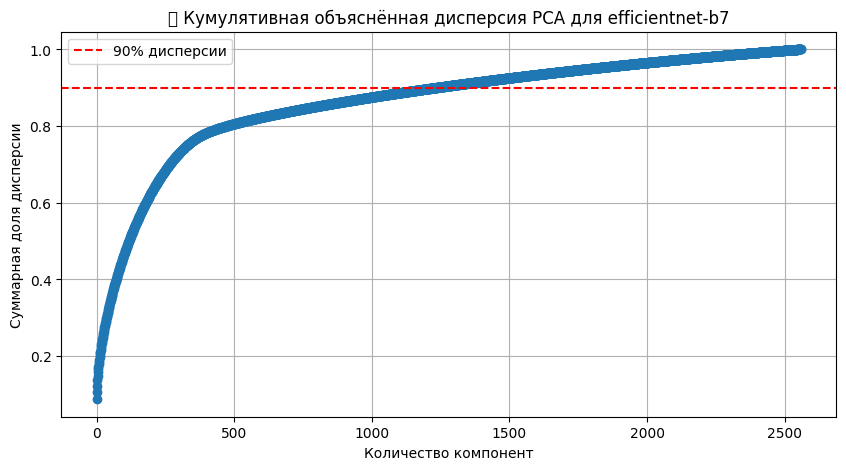

In [4]:
#
for file_1 in descriptor_files:
   key_1 = file_1.replace('.pickle', '')
   # Загружаем дескрипторы
   X = data[key_1]

   # Стандартизируем
   ##scaler = StandardScaler()
   scaler = RobustScaler()
   X_scaled = scaler.fit_transform(X)

   # Запускаем PCA без ограничения на количество компонент
   pca_full = PCA()
   pca_full.fit(X_scaled)

   # Вычисляем кумулятивную долю объяснённой дисперсии
   explained_variance_ratio = np.cumsum(pca_full.explained_variance_ratio_)

   # Визуализируем
   if key_1 == 'efficientnet-b7':
       plt.figure(figsize=(10, 5))
       plt.plot(explained_variance_ratio, marker='o', linewidth=2)
       plt.axhline(y=0.9, color='r', linestyle='--', label='90% дисперсии')
       plt.title(f'📈 Кумулятивная объяснённая дисперсия PCA для {key_1}')
       plt.xlabel('Количество компонент')
       plt.ylabel('Суммарная доля дисперсии')
       plt.grid(True)
       plt.legend()
       plt.show()

Обратим внимание на перегиб на графике. Его можно принять в районе 300 компонент. Правда, такое количество признаков будед объяснять около 75% диссперсии, но согласимся с таким процентом ради уменьшения числа признаков до 300 в дескрипторе efficientnet-b7.

In [5]:
#
# Исходный EfficientNet дескриптор
X_eff = data['efficientnet-b7']

# Стандартизация
##scaler = StandardScaler()
##scaler = MinMaxScaler()
scaler = RobustScaler()
X_eff_scaled = scaler.fit_transform(X_eff)
#
# PCA на 300 компонент
pca_eff = PCA(n_components=300, random_state=42)
X_eff_reduced = pca_eff.fit_transform(X_eff_scaled)

# Сохраняем в словарь отдельно
data_reduced_400 = { 'efficientnet-b7': pd.DataFrame(X_eff_reduced) }

print(f'✅ EfficientNet-B7 пересчитан: {X_eff_reduced.shape[0]} изображений, {X_eff_reduced.shape[1]} компонент')


✅ EfficientNet-B7 пересчитан: 416314 изображений, 300 компонент


In [6]:
# Заменим дескриптор efficientnet-b7 в основном словаре
data_reduced['efficientnet-b7'] = data_reduced_400['efficientnet-b7']

# Проверим ключи
print('🧩 Обновлённые дескрипторы:')
for key in data_reduced.keys():
    print(f' - {key}: {data_reduced[key].shape}')


🧩 Обновлённые дескрипторы:
 - efficientnet-b7: (416314, 300)
 - osnet: (416314, 4)
 - vdc_color: (416314, 68)
 - vdc_type: (416314, 16)


## 3. Моделирование и оценка качества модели

### 3.1. Кластеризация изображений

После предобработки исходных данных произведите кластеризацию для каждого набора дескрипторов.

Для решения задачи используйте несколько различных методов, подобрав оптимальное количество кластеров для каждого метода и варианта дескрипторов.

В качестве метрики для подбора оптимального количества кластеров используйте внутренние меры индекс Калински — Харабаса (`calinski_harabasz_score`) и индекс Дэвиса — Болдина (`davies_bouldin_score`).

Рекомендуем вынести код для построения моделей кластеризации и подбора их параметров в отдельную функцию, чтобы не множить одинаковый код для четырёх случаев дескрипторов.

**Примечание.** Поскольку исходных данных много, могут возникнуть проблемы с оперативной памятью и скоростью работы таких алгоритмов, как K-Means. Вместо стандартного алгоритма K-Means можно воспользоваться реализацией MiniBatchKMeans. 

**Примечание.** Постарайтесь написать чистый код, максимально уменьшая количество дублирующихся участков.

В качестве методов кластеризации используются : KMeans, Birch и Agglomerative. Первый из них ( KMeans ) сработал успешно с полным количеством строк (416314). Методы Birch и Agglomerative категорически вылетают по памяти. Google colab при всех ухищрениях стал вылетать по памяти еще при применении PCA. Поэтому, метод KMeans рассчитан честно, для полного количества наблюдений. Остальные два метода используют рандомную выборку 10% от общего числа строк , то есть около 40000. 

In [7]:
def evaluate_clustering(X, method, method_name, cluster_range=range(2, 11)):
#
##    length = len(X)
##    print(f'Длина массива X: {length}')
#
    results = []
    for k in cluster_range:
        model = method(n_clusters=k)
        labels = model.fit_predict(X)
        score_ch = calinski_harabasz_score(X, labels)
        score_db = davies_bouldin_score(X, labels)
        results.append({
            'method': method_name,
            'n_clusters': k,
            'calinski_harabasz': score_ch,
            'davies_bouldin': score_db
        })
    return pd.DataFrame(results)
#
# Словари для хранения результатов
methods = {
    'KMeans': KMeans,
    'Birch': Birch,
    'Agglomerative': AgglomerativeClustering
}

cluster_scores = {}         # метрики кластеризации
cluster_labels = {}         # метки кластеров

for key, X in data_reduced.items():
    print(f'🔍 Обрабатываем дескриптор: {key}')
    df_list = []
    cluster_labels[key] = {}  # создаём вложенный словарь для каждого дескриптора

    for method_name, method in methods.items():
        print('программа считает', method_name)

        # Подвыборка для тяжёлых дескрипторов
        if method_name in ['Birch', 'Agglomerative']:
            if key in ['efficientnet-b7', 'osnet', 'vdc_color', 'vdc_type']:
                X_subsampled = X.sample(frac=0.1, random_state=42)
            else:
                X_subsampled = X
        else:
            X_subsampled = X

        # Оценка кластеризации
        result_df = evaluate_clustering(X_subsampled, method, method_name)
        df_list.append(result_df)
#
# Сохраняем метки кластеров для одного значения k (например, k=10)
        model = method(n_clusters=5)
        labels = model.fit_predict(X_subsampled)
        cluster_labels[key][method_name] = labels.copy()

    cluster_scores[key] = pd.concat(df_list, ignore_index=True)


🔍 Обрабатываем дескриптор: efficientnet-b7
программа считает KMeans


программа считает Birch
программа считает Agglomerative
🔍 Обрабатываем дескриптор: osnet
программа считает KMeans
программа считает Birch
программа считает Agglomerative
🔍 Обрабатываем дескриптор: vdc_color
программа считает KMeans
программа считает Birch
программа считает Agglomerative
🔍 Обрабатываем дескриптор: vdc_type
программа считает KMeans
программа считает Birch
программа считает Agglomerative


Построим графики для полученных метрик для каждого дескриптора

📊 Строим графики для дескриптора: efficientnet-b7


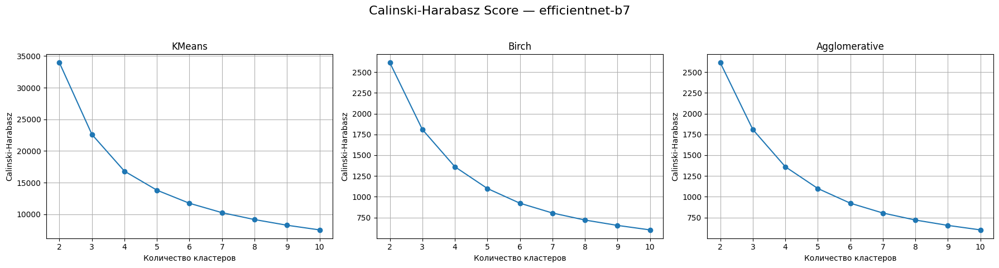

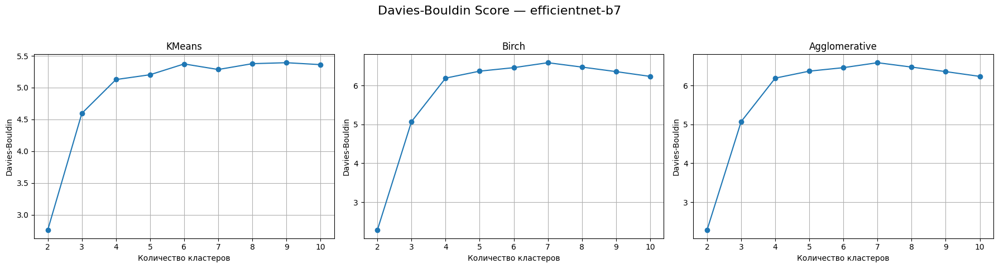

📊 Строим графики для дескриптора: osnet


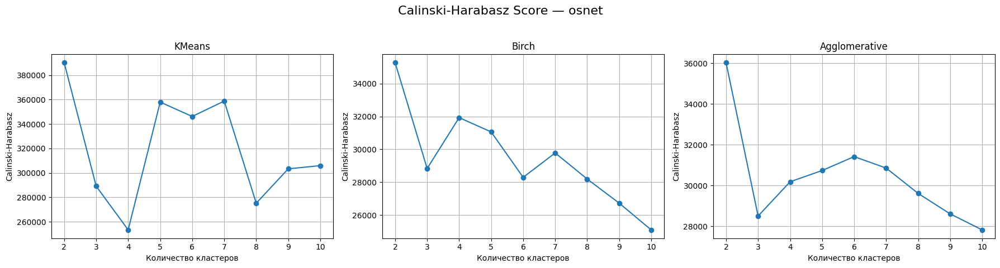

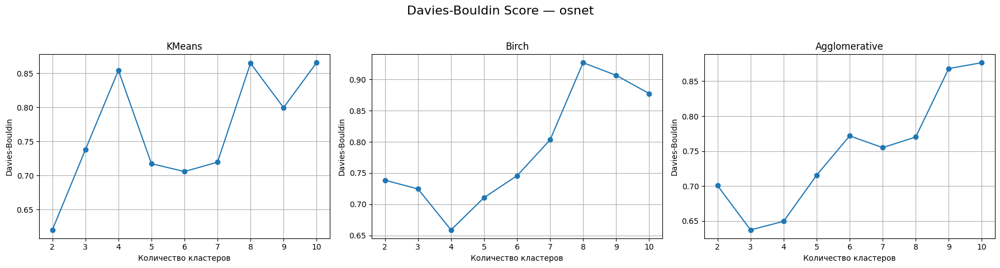

📊 Строим графики для дескриптора: vdc_color


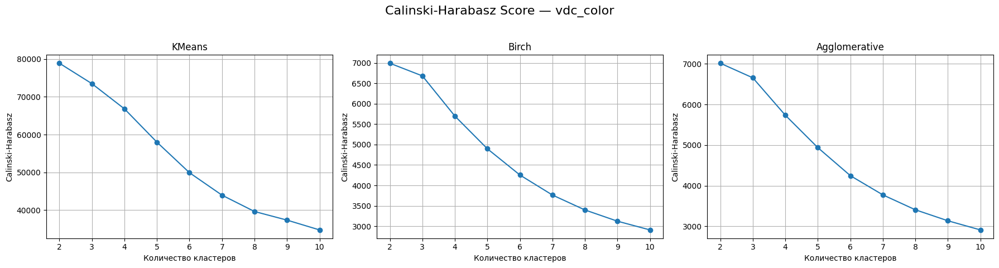

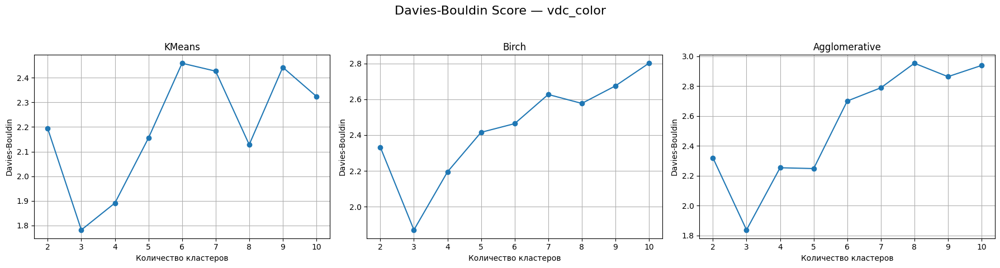

📊 Строим графики для дескриптора: vdc_type


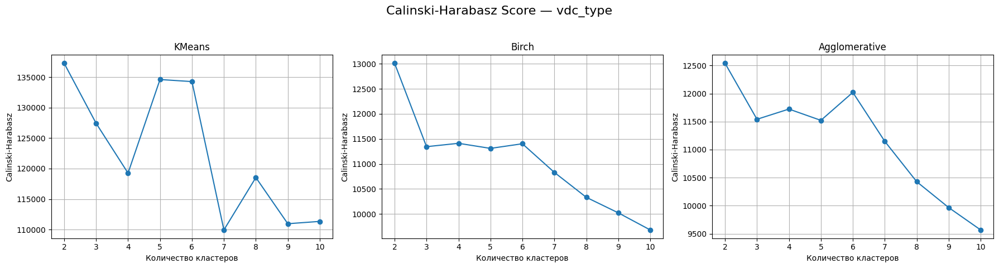

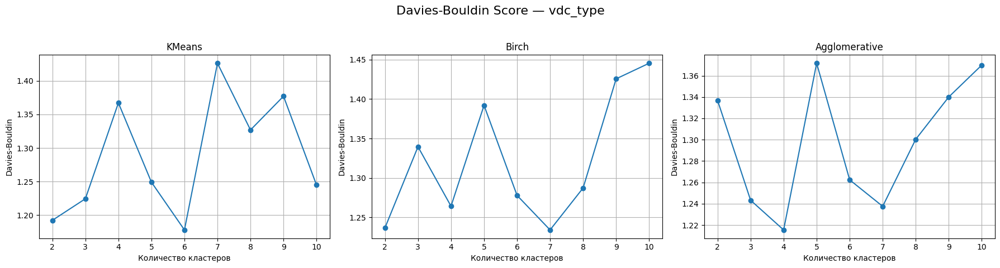

In [8]:
for key in cluster_scores:
    print(f'📊 Строим графики для дескриптора: {key}')
    scores_df = cluster_scores[key]

    # Создаём фигуру с 3 графиками для Calinski-Harabasz
    fig_ch, axes_ch = plt.subplots(1, 3, figsize=(18, 5))
    fig_ch.suptitle(f'Calinski-Harabasz Score — {key}', fontsize=16)

    for i, method_name in enumerate(methods.keys()):
        method_scores = scores_df[scores_df['method'] == method_name]
        axes_ch[i].plot(method_scores['n_clusters'], method_scores['calinski_harabasz'], marker='o')
        axes_ch[i].set_title(method_name)
        axes_ch[i].set_xlabel('Количество кластеров')
        axes_ch[i].set_ylabel('Calinski-Harabasz')
        axes_ch[i].grid(True)

    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

    # Создаём фигуру с 3 графиками для Davies-Bouldin
    fig_db, axes_db = plt.subplots(1, 3, figsize=(18, 5))
    fig_db.suptitle(f'Davies-Bouldin Score — {key}', fontsize=16)

    for i, method_name in enumerate(methods.keys()):
        method_scores = scores_df[scores_df['method'] == method_name]
        axes_db[i].plot(method_scores['n_clusters'], method_scores['davies_bouldin'], marker='o')
        axes_db[i].set_title(method_name)
        axes_db[i].set_xlabel('Количество кластеров')
        axes_db[i].set_ylabel('Davies-Bouldin')
        axes_db[i].grid(True)

    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

In [9]:
best_results = []

for key, scores_df in cluster_scores.items():
##    print(f'🔍 Анализ дескриптора: {key}')
    
    for method_name in methods.keys():
        method_scores = scores_df[scores_df['method'] == method_name]

        # Находим k с максимальным CH и минимальным DB
        best_ch_row = method_scores.loc[method_scores['calinski_harabasz'].idxmax()]
        best_db_row = method_scores.loc[method_scores['davies_bouldin'].idxmin()]

        best_results.append({
            'descriptor': key,
            'method': method_name,
            'best_k_ch': int(best_ch_row['n_clusters']),
            'ch_score': best_ch_row['calinski_harabasz'],
            'best_k_db': int(best_db_row['n_clusters']),
            'db_score': best_db_row['davies_bouldin']
        })

# Преобразуем в DataFrame
best_df = pd.DataFrame(best_results)

# Выводим таблицу
print('\n📊 Лучшие параметры кластеризации:')
print(best_df.sort_values(by=['descriptor', 'ch_score'], ascending=[True, False]))


📊 Лучшие параметры кластеризации:
         descriptor         method  best_k_ch       ch_score  best_k_db  \
0   efficientnet-b7         KMeans          2   33947.025117          2   
1   efficientnet-b7          Birch          2    2612.317474          2   
2   efficientnet-b7  Agglomerative          2    2612.317474          2   
3             osnet         KMeans          2  390220.929865          2   
5             osnet  Agglomerative          2   36024.454184          3   
4             osnet          Birch          2   35271.773671          4   
6         vdc_color         KMeans          2   78891.697897          3   
8         vdc_color  Agglomerative          2    7015.782076          3   
7         vdc_color          Birch          2    6991.612947          3   
9          vdc_type         KMeans          2  137272.863641          6   
10         vdc_type          Birch          2   13012.121678          7   
11         vdc_type  Agglomerative          2   12540.535130     

Мы вывели таблицу так называемых лучших разбиений на кластеры по каждому дескриптору и по каждому методу. В итоге мы видим, что лучшее разбиение (
то есть максимум метрики Calinski-Harabasz и минимум Davies-Bouldin) довольно часто соответствует  2-м кластерам. Но это  вовсе не означает, что это оптимальное число кластеров для нашей задачи.
Метрики оценивают геометрическое качество. CH и DB метрики смотрят на компактность и разделённость кластеров. При k=2 часто получается максимальное разделение — особенно если данные имеют глобальную структуру (например, "фон vs объект"). Что мы и наблюдаем на наших изображениях. Мы же разыскиваем симантические группы (кластеры).

### 3.2. Интерпретация кластеров

#### 3.2.1 Визуализация кластеров

Визуализируйте результаты кластеризации в двух- или трёхмерном пространстве, предварительно понизив размерность дескрипторов изображений до соответствующих размерностей с помощью метода t-SNE. 

По результатам визуализации кластеров сделайте предположение о качестве полученной кластеризации.

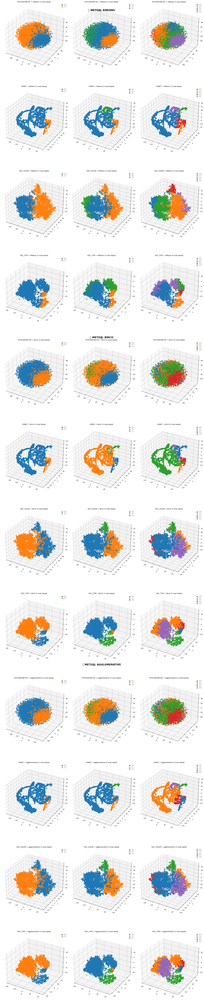

In [10]:
# Методы кластеризации
methods = {
    'KMeans': KMeans,
    'Birch': Birch,
    'Agglomerative': AgglomerativeClustering
}

# Список дескрипторов и количества кластеров
descriptor_files_1 = ['efficientnet-b7', 'osnet', 'vdc_color', 'vdc_type']
cluster_values = [2, 3, 5]

# Подготовка общей фигуры
fig = plt.figure(figsize=(18, 90))
plot_index = 1

# Координаты заголовков методов (Y позиции на фигуре)
method_titles = {
    'KMeans': 0.98,
    'Birch': 0.66,
    'Agglomerative': 0.34
}

# Функция визуализации одного графика
def tsne_3d_plot(X, labels, title, subplot_index):
    tsne = TSNE(n_components=3, perplexity=30, random_state=42)
    X_embedded = tsne.fit_transform(X)

    df_tsne = pd.DataFrame(X_embedded, columns=['X', 'Y', 'Z'])
    df_tsne['Cluster'] = labels

    ax = fig.add_subplot(12, 3, subplot_index, projection='3d')
    for cluster_id in sorted(df_tsne['Cluster'].unique()):
        subset = df_tsne[df_tsne['Cluster'] == cluster_id]
        ax.scatter(subset['X'], subset['Y'], subset['Z'], label=f'C {cluster_id}', s=40)

    ax.set_title(title, fontsize=10)
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('Z')
    ax.legend(loc='best', fontsize=7)

# Основной цикл по методам
for method_name, method_cls in methods.items():
    # Заголовок метода по ширине всей фигуры
    fig.text(0.5, method_titles[method_name], f'📌 МЕТОД: {method_name.upper()}',
             ha='center', va='center', fontsize=16, fontweight='bold')
    #
    # Цикл по дескрипторам и числу кластеров
    for desc_name in descriptor_files_1:
        # Подвыборка для t-SNE
        X_sampled = data_reduced[desc_name].sample(frac=0.01, random_state=42)

        for n_clusters in cluster_values:
            model = method_cls(n_clusters=n_clusters)
            labels = model.fit_predict(X_sampled)

            graph_title = f'{desc_name.upper()} + {method_name} ({n_clusters} кластеров)'
            tsne_3d_plot(X_sampled, labels, graph_title, plot_index)
            plot_index += 1

# Финальный вывод
plt.tight_layout()
plt.show()

Мы вывели трехмерные изображения по всем дескрипторам и каждого из трех методов кластеризации (KMeans, Birch, Agglomerative) для 2,3 и 5 кластерам. Хорошо видно ( например по дескриптору vdc_type), что все методы дают существенно схожие результаты. Это, в целом, хороший симптом, показывающий повторяемость, а значит, скорее всего и "правильность" разбиений. На этом же дескрипторе (vdc_type) визуально очень хорошо прослеживается и логичность разбиений на 2,3 и 5 кластеров. В других дескрипторах, особенно в effitientnet-b7 о качестве разбиения визуально вряд ли можно что либо сказать.

#### 3.2.2. Визуализация изображений в кластере


Визуализируйте несколько изображений из каждого кластера, чтобы проинтерпретировать результаты.

**Как визуализировать изображения, соответствующие определённому кластеру?**

**Для визуализации самих изображений из кластеров будем использовать другую программу, нежели предложена в задании.**

Добавим в таблицу путей images_paths.csv номер кластера для каждой строки того дескриптора, который мы визуализируем (столбец cluster).

In [11]:
#
# Загрузка путей
df_paths = pd.read_csv(r'G:\Skillfactory\IntelliVision_case\IntelliVision_case\images_paths.csv')

# Получение меток кластеров , соответствующие одному дескриптору и одному методу
labels_kmeans = cluster_labels['vdc_color']['KMeans']

# Проверка длины
assert len(df_paths) == len(labels_kmeans), "Количество меток не совпадает с количеством путей!"

# Добавление столбца кластеров
df_paths['cluster'] = labels_kmeans
#
df_paths.to_csv('image_paths_with_kmeans_clusters.csv', index=False) # сохранение df с путями и номерами кластеров
#
# Просмотр результата
display(df_paths)
#

,paths,cluster
0,veriwild\1\00001\000001.jpg,2
1,veriwild\1\00001\000002.jpg,2
2,veriwild\1\00001\000003.jpg,0
3,veriwild\1\00001\000004.jpg,2
4,veriwild\1\00001\000005.jpg,0
...,...,...
416309,veriwild\9\36189\369999.jpg,2
416310,veriwild\9\36190\370000.jpg,0
416311,veriwild\9\36190\370001.jpg,2
416312,veriwild\9\36190\370002.jpg,2


Теперь добавим столбец с полным путем

In [12]:
# Добавляем столбец с полным путём
base_path = r'G:\Skillfactory\IntelliVision_case\IntelliVision_case\raw_data'  
df_paths['full_paths'] = df_paths['paths'].apply(lambda x: f"{base_path}\\{x}")

In [13]:
pd.set_option('display.max_colwidth', None)
display(df_paths['full_paths'])

0         G:\Skillfactory\IntelliVision_case\IntelliVision_case\raw_data\veriwild\1\00001\000001.jpg
1         G:\Skillfactory\IntelliVision_case\IntelliVision_case\raw_data\veriwild\1\00001\000002.jpg
2         G:\Skillfactory\IntelliVision_case\IntelliVision_case\raw_data\veriwild\1\00001\000003.jpg
3         G:\Skillfactory\IntelliVision_case\IntelliVision_case\raw_data\veriwild\1\00001\000004.jpg
4         G:\Skillfactory\IntelliVision_case\IntelliVision_case\raw_data\veriwild\1\00001\000005.jpg
                                                     ...                                            
416309    G:\Skillfactory\IntelliVision_case\IntelliVision_case\raw_data\veriwild\9\36189\369999.jpg
416310    G:\Skillfactory\IntelliVision_case\IntelliVision_case\raw_data\veriwild\9\36190\370000.jpg
416311    G:\Skillfactory\IntelliVision_case\IntelliVision_case\raw_data\veriwild\9\36190\370001.jpg
416312    G:\Skillfactory\IntelliVision_case\IntelliVision_case\raw_data\veriwild\9\36190\3

***Теперь выводим изображения, соответствующие 5-ти кластерам (от 0 до 4) для дескриптора vdc_color***

🖼️ Визуализация кластера 0


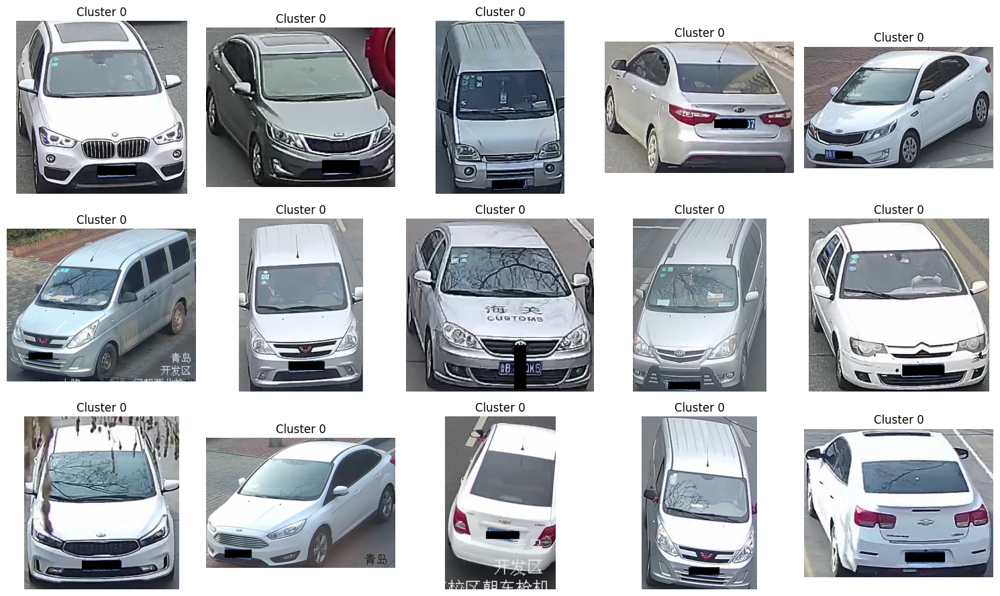

🖼️ Визуализация кластера 1


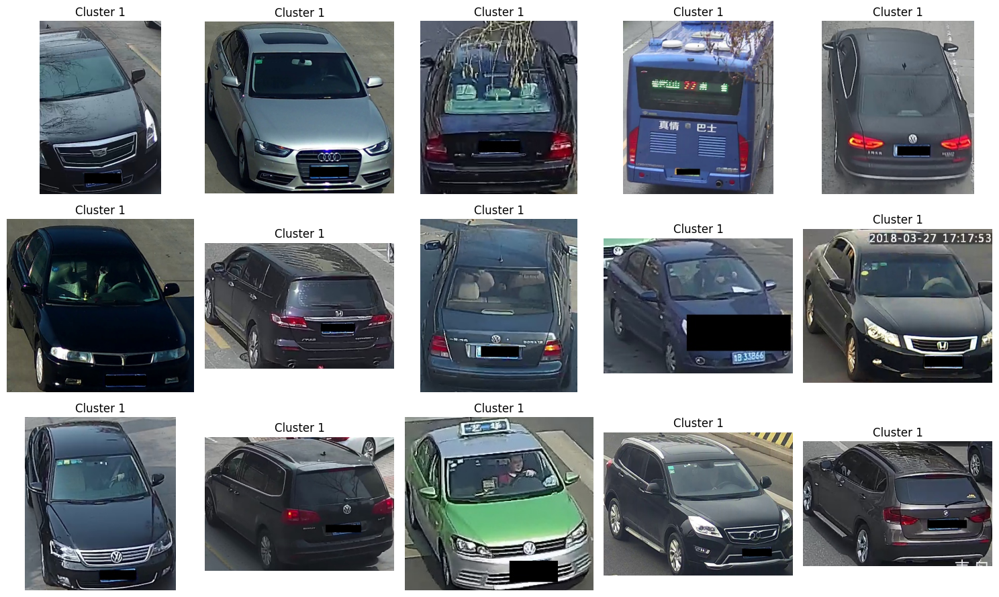

🖼️ Визуализация кластера 2


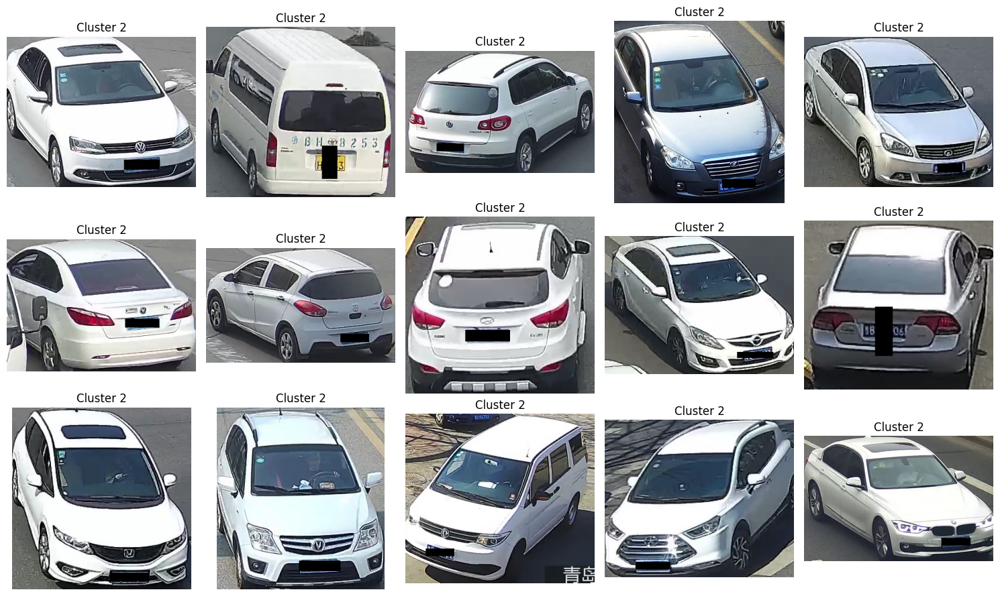

🖼️ Визуализация кластера 3


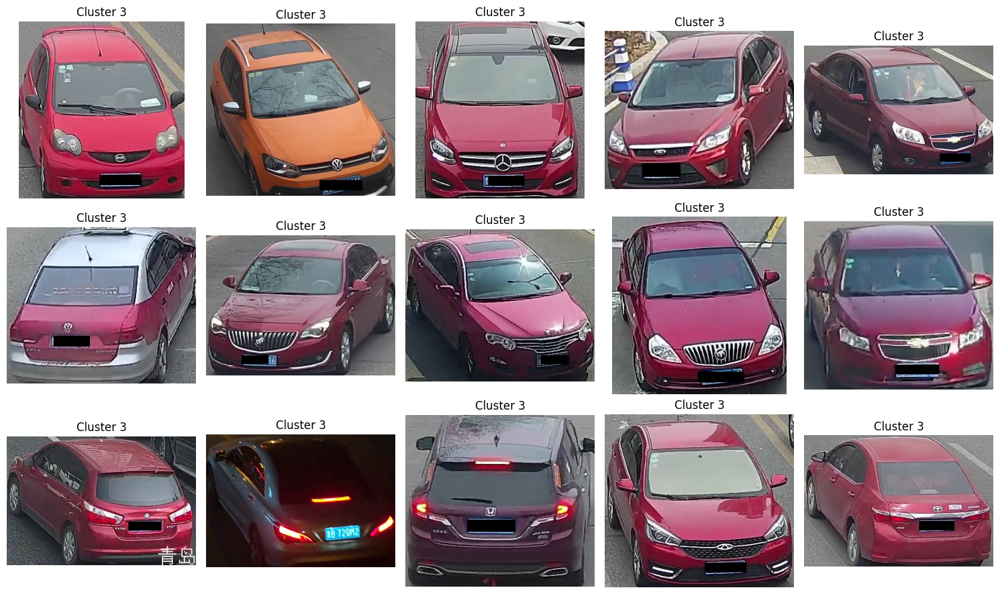

🖼️ Визуализация кластера 4


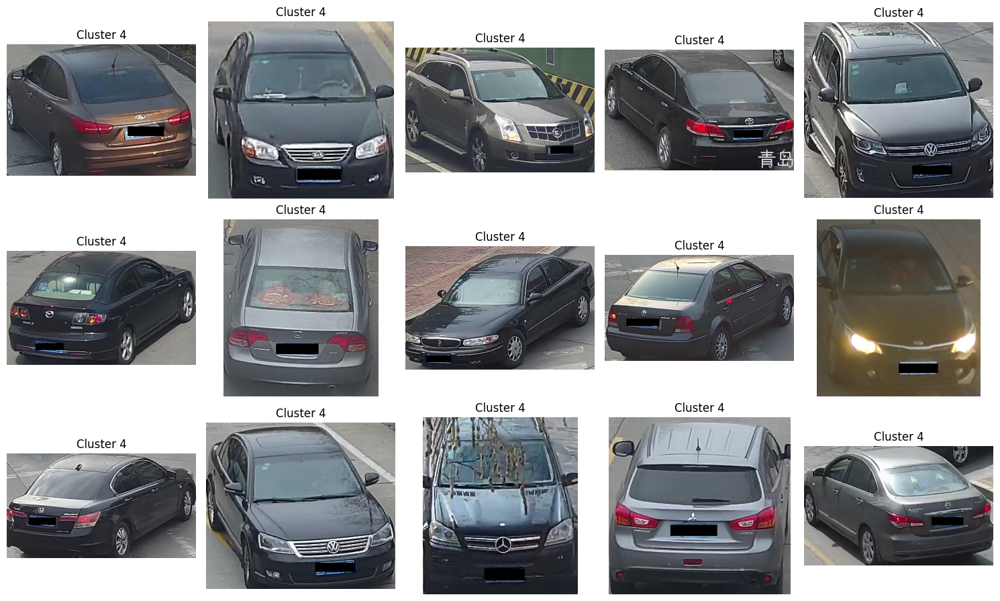

In [14]:
def show_cluster_images(df, cluster_id, n_images=15):
    # Фильтруем по кластеру и выбираем случайные изображения
    sample_paths = df[df['cluster'] == cluster_id]['full_paths'].sample(n_images, random_state=42)

    # Создаём галерею
    fig, axes = plt.subplots(3, 5, figsize=(15, 9))
    axes = axes.flatten()

    for ax, path in zip(axes, sample_paths):
        try:
            img = mpimg.imread(path)
            ax.imshow(img)
            ax.axis('off')
            ax.set_title(f'Cluster {cluster_id}')
        except Exception as e:
            ax.axis('off')
            ax.set_title('Ошибка')
            print(f'⚠️ Ошибка при загрузке {path}: {e}')

    plt.tight_layout()
    plt.show()
#
for cluster_id in [0, 1, 2, 3, 4]:
    print(f'🖼️ Визуализация кластера {cluster_id}')
    show_cluster_images(df_paths, cluster_id, n_images=15)

Хорошо видно, что изображения, попавшие в каждый из кластеров существенно группируются по цветам. Например кластер 0 в данном выводе это в основном черные машины, кластер 2 это приемущественно красные ( за некоторыми исключениями). Однако, видно, что кластеры 0, 3 и кластеры 1 и 4 очень похожи друг на друга. Это говорить о перекрытии кластеров. На это указывает и метрика davies-Bouldin, которая ~ 1.8, что довольно много.

**Посмотрим еще на vdc_type**


🖼️ Визуализация кластера 0


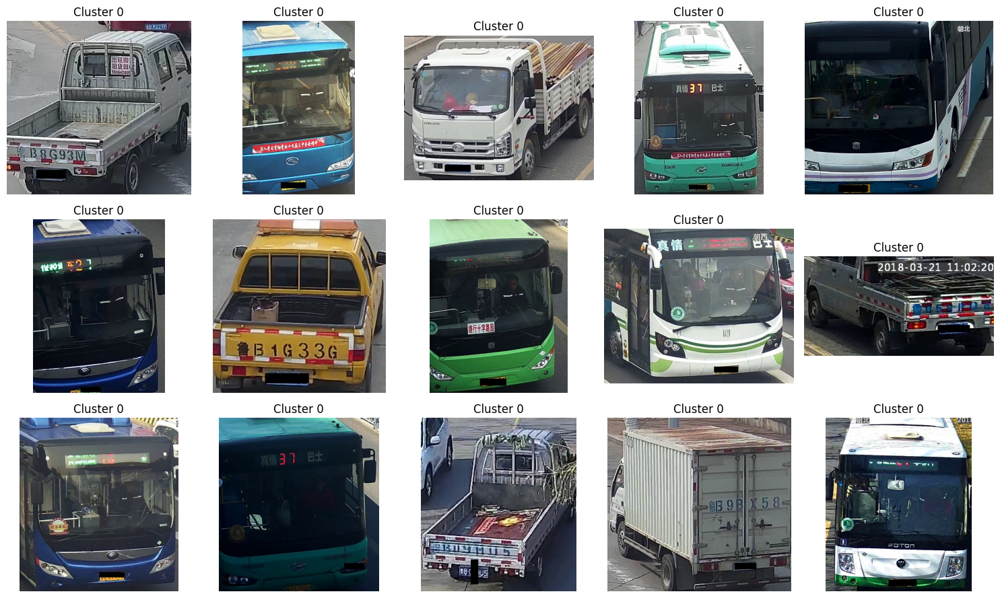

🖼️ Визуализация кластера 1


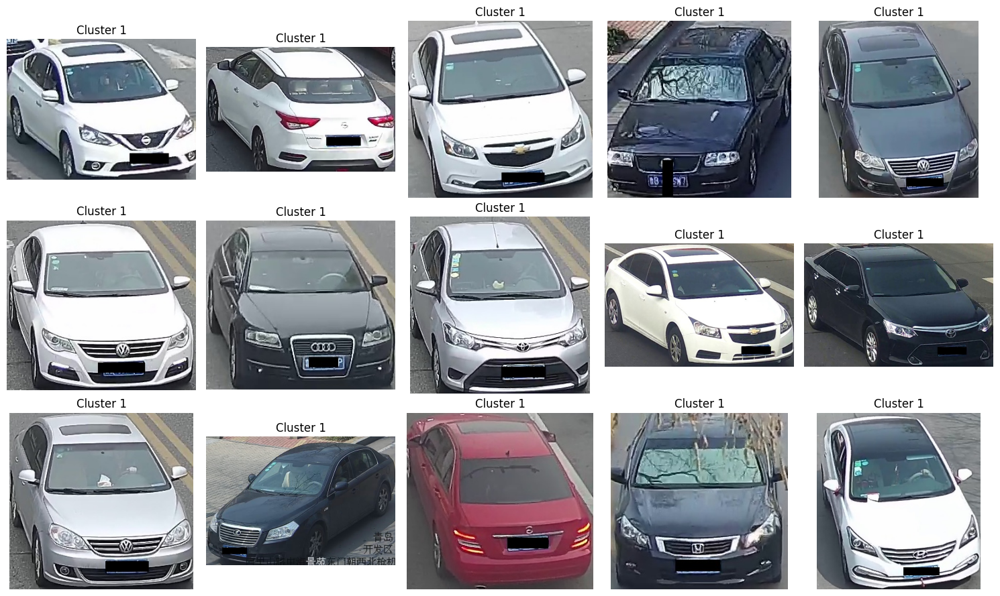

🖼️ Визуализация кластера 2


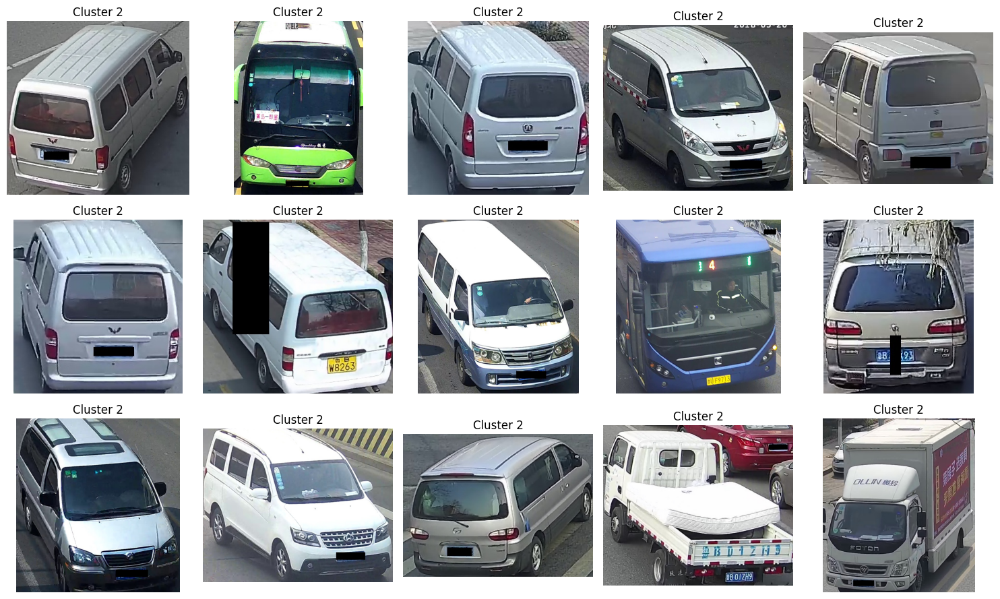

🖼️ Визуализация кластера 3


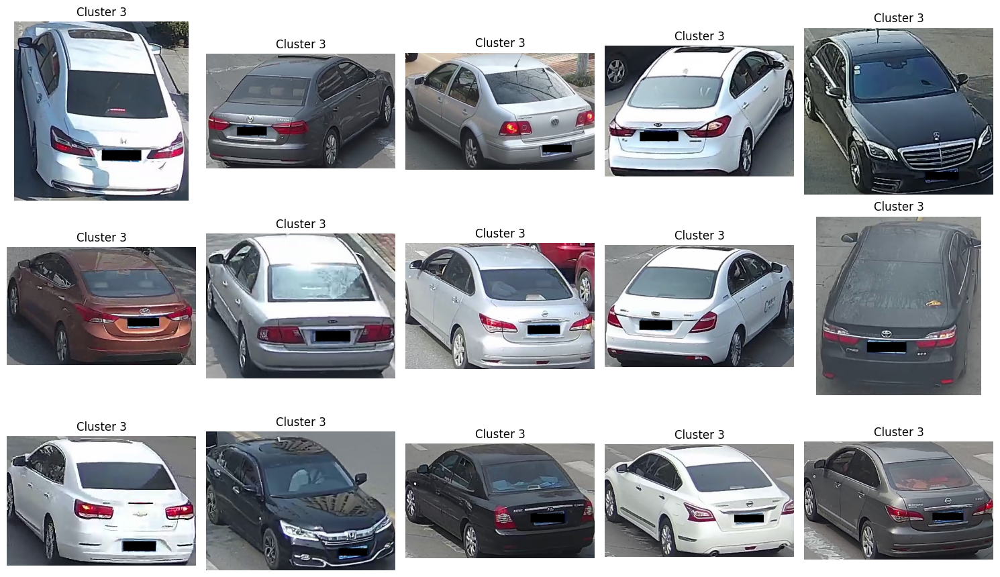

🖼️ Визуализация кластера 4


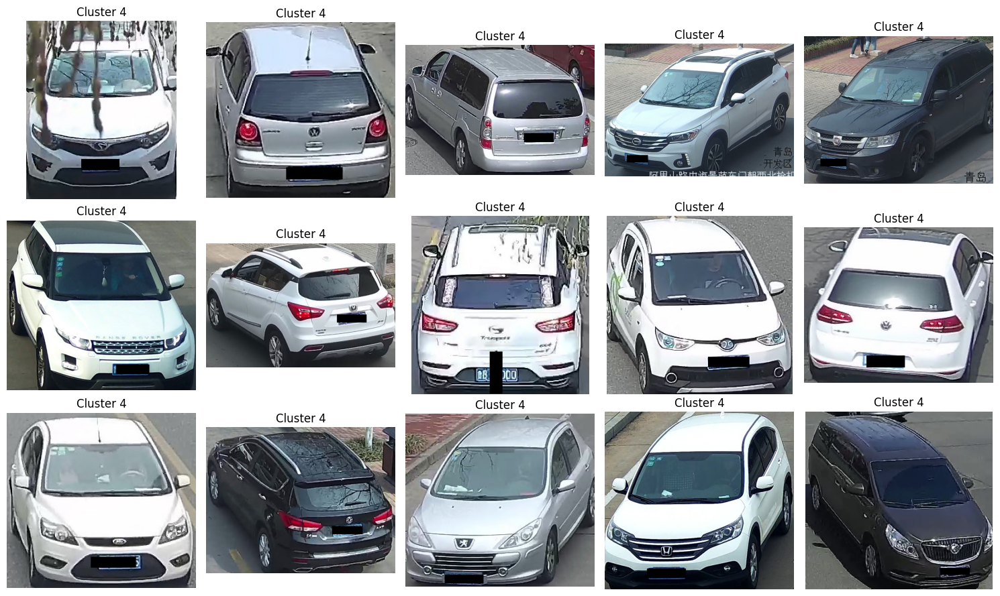

In [15]:
#
# Загрузка путей
df_paths = pd.read_csv(r'G:\Skillfactory\IntelliVision_case\IntelliVision_case\images_paths.csv')

# Получение меток кластеров , соответствующие одному дескриптору и одному методу
labels_kmeans = cluster_labels['vdc_type']['KMeans']

# Проверка длины
assert len(df_paths) == len(labels_kmeans), "Количество меток не совпадает с количеством путей!"

# Добавление столбца кластеров
df_paths['cluster'] = labels_kmeans
#
df_paths.to_csv('image_paths_with_kmeans_clusters.csv', index=False) # сохранение df с путями и номерами кластеров
#
# Добавляем столбец с полным путём
base_path = r'G:\Skillfactory\IntelliVision_case\IntelliVision_case\raw_data'  
df_paths['full_paths'] = df_paths['paths'].apply(lambda x: f"{base_path}\\{x}")
#
pd.set_option('display.max_colwidth', None)
def show_cluster_images(df, cluster_id, n_images=15):
    # Фильтруем по кластеру и выбираем случайные изображения
    sample_paths = df[df['cluster'] == cluster_id]['full_paths'].sample(n_images, random_state=42)

    # Создаём галерею
    fig, axes = plt.subplots(3, 5, figsize=(15, 9))
    axes = axes.flatten()

    for ax, path in zip(axes, sample_paths):
        try:
            img = mpimg.imread(path)
            ax.imshow(img)
            ax.axis('off')
            ax.set_title(f'Cluster {cluster_id}')
        except Exception as e:
            ax.axis('off')
            ax.set_title('Ошибка')
            print(f'⚠️ Ошибка при загрузке {path}: {e}')

    plt.tight_layout()
    plt.show()
#
for cluster_id in [0, 1, 2, 3, 4]:
    print(f'🖼️ Визуализация кластера {cluster_id}')
    show_cluster_images(df_paths, cluster_id, n_images=15)

Видно, что кластеры соответствуют в основном: 0 - автобусы и грузовички, 1- хетчбэк, 2- минивын(типа газель), 3- седаны, 4- универсал

### 3.3. Поиск выбросов

С помощью известных вам методов поиска выбросов (например, DBSCAN) попытайтесь найти выбросы среди изображений, используя все варианты дескрипторов. Подберите параметры алгоритма.

Визуализируйте изображения, попавшие в раздел выбросов, и попробуйте проинтерпретировать полученные результаты. Подумайте, почему именно эти изображения попали в выбросы.

Сравните результаты для всех вариантов дескрипторов. Какой вариант дескрипторов даёт наилучшее представление о выбросах?



Подбираем два параметра (eps, min_samples) для программы DBSCAN. Первый параметр показывает расстояния от каждого объекта ( наблюдения), в которое помещается min_samples его соседей. Если соседей помещается меньше, чем min_samples, то они считаются выбросами. Для подбора параметра eps используем следующий график :

🔍 Обрабатываем дескриптор: efficientnet-b7


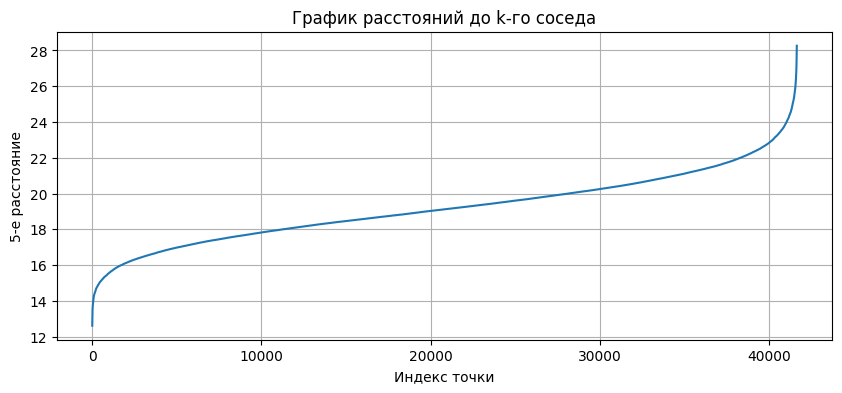

🔍 Обрабатываем дескриптор: osnet


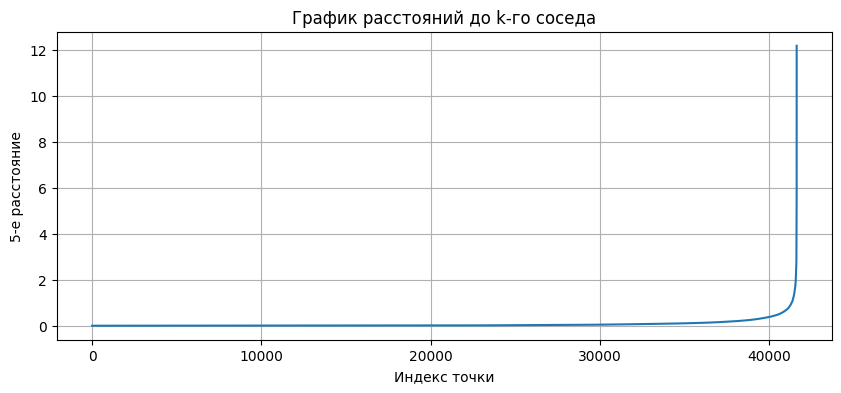

🔍 Обрабатываем дескриптор: vdc_color


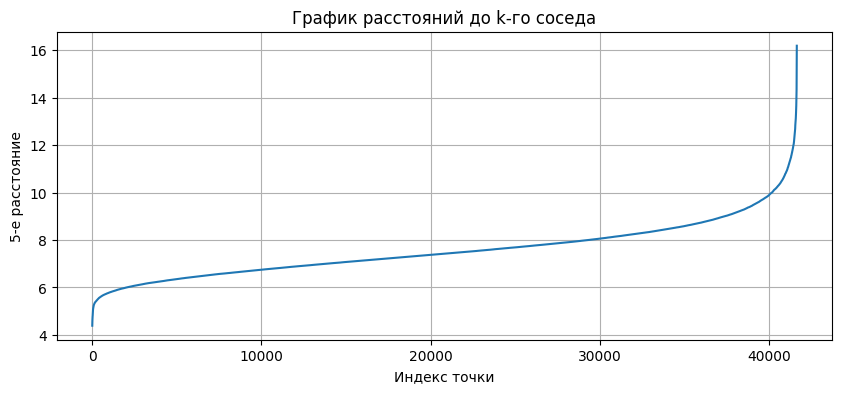

🔍 Обрабатываем дескриптор: vdc_type


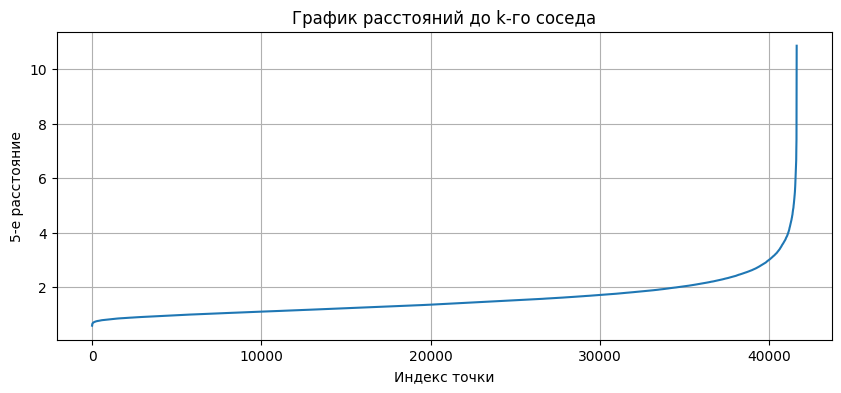

In [16]:
def plot_k_distance(X, k=5):
    neigh = NearestNeighbors(n_neighbors=k)
    nbrs = neigh.fit(X)
    distances, _ = nbrs.kneighbors(X)
    distances = np.sort(distances[:, k-1])
    plt.figure(figsize=(10, 4))
    plt.plot(distances)
    plt.title('График расстояний до k-го соседа')
    plt.xlabel('Индекс точки')
    plt.ylabel(f'{k}-е расстояние')
    plt.grid(True)
    plt.show()
#
#
for key, X in data_reduced.items():
#
    X_subsampled = X.sample(frac=0.1, random_state=42)
    X_scaled = StandardScaler().fit_transform(X_subsampled)
#
    print(f'🔍 Обрабатываем дескриптор: {key}')
    plot_k_distance(X_scaled, k=5)

Первоначальное значение eps сооьветствует расстоянию ( ось ординет), которое соответствует моменту резкого взлета кривой. Например, для дескриптора effitientnet-b7 значение eps~23. Значения параметра min_samples подбираем интуитивно, опираясь на следующее предположение (на основе количества признаков):
2-10 признаков min_samples [4,5], 10-50 признаков [5-10], >50 признаков min_samples=[10,20]     Основная идея: чтобы уменьшить количество выбросов нужно увеличивать eps (тогда больше соседей будет попадать в радиус) или уменьшать min_samples (тогда соседи с больщей гарантией попадут в радиус eps).

Визуализируем выбросы.

In [17]:
outlier_labels = {}
paths_escape = {}  # ← Новый словарь для хранения путей к выбросам
i_eps = 0

# Список параметров eps
##eps_list = [22.0, 12.0, 9.0, 2.0]
##min_samples_list = [31, 20, 10, 6]
##eps_list = [25.0, 15.0, 12.0, 3.0]
##min_samples_list = [23, 15, 7, 4]
eps_list = [22.0, 0.7, 10.0, 3.0]
min_samples_list = [23, 3, 7, 4]

for key, X in data_reduced.items():
    print(f'🔍 DBSCAN для дескриптора: {key}')
    
    X_subsampled = X.sample(frac=0.01, random_state=42)
    sample_indices = X_subsampled.index  # сохраняем индексы
    
    X_scaled = StandardScaler().fit_transform(X_subsampled)
    
    print(f'🔧 Пробуем DBSCAN с eps = {eps_list[i_eps]}')
    dbscan = DBSCAN(eps=eps_list[i_eps], min_samples=min_samples_list[i_eps])
    labels = dbscan.fit_predict(X_scaled)
    
    # Сохраняем метки
    outlier_labels[key] = labels
    
    # Получаем индексы выбросов
    outlier_mask = labels == -1
    outlier_indices = sample_indices[outlier_mask]
    
    # Получаем пути к выбросам
    outlier_paths = df_paths.loc[outlier_indices, 'full_paths']
    
    # Сохраняем пути в словарь
    paths_escape[key] = outlier_paths.tolist()  # ← сохраняем как список строк
    
    # Статистика
    n_outliers = np.sum(labels == -1)
    n_clusters = len(set(labels)) - (1 if -1 in labels else 0)
    print(f'→ Найдено кластеров: {n_clusters}, выбросов: {n_outliers}')
    
    i_eps += 1


🔍 DBSCAN для дескриптора: efficientnet-b7
🔧 Пробуем DBSCAN с eps = 22.0
→ Найдено кластеров: 1, выбросов: 399
🔍 DBSCAN для дескриптора: osnet
🔧 Пробуем DBSCAN с eps = 0.7
→ Найдено кластеров: 8, выбросов: 99
🔍 DBSCAN для дескриптора: vdc_color
🔧 Пробуем DBSCAN с eps = 10.0
→ Найдено кластеров: 1, выбросов: 219
🔍 DBSCAN для дескриптора: vdc_type
🔧 Пробуем DBSCAN с eps = 3.0
→ Найдено кластеров: 3, выбросов: 253



🔍 Дескриптор: efficientnet-b7


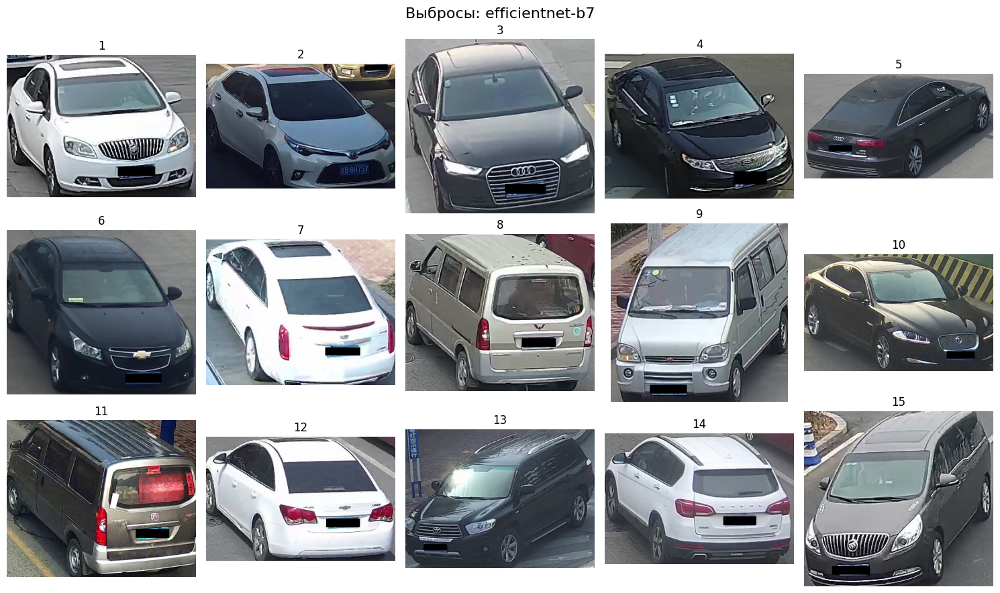


🔍 Дескриптор: osnet


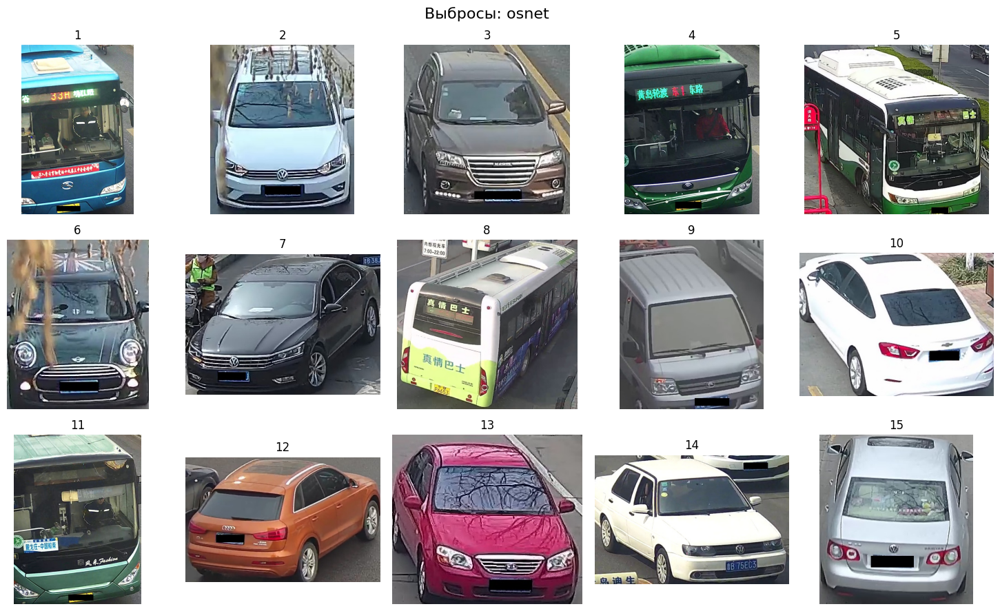


🔍 Дескриптор: vdc_color


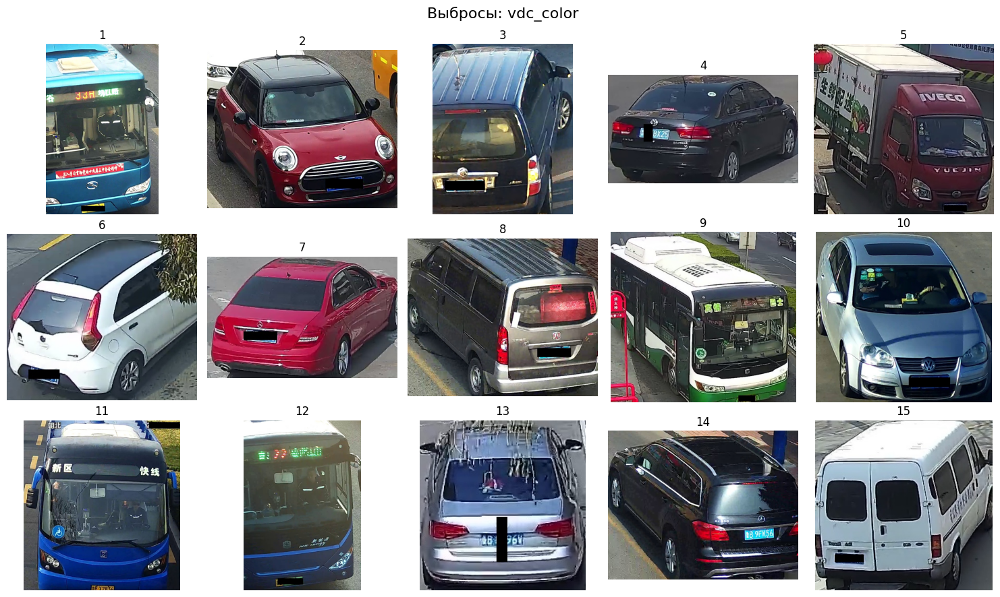


🔍 Дескриптор: vdc_type


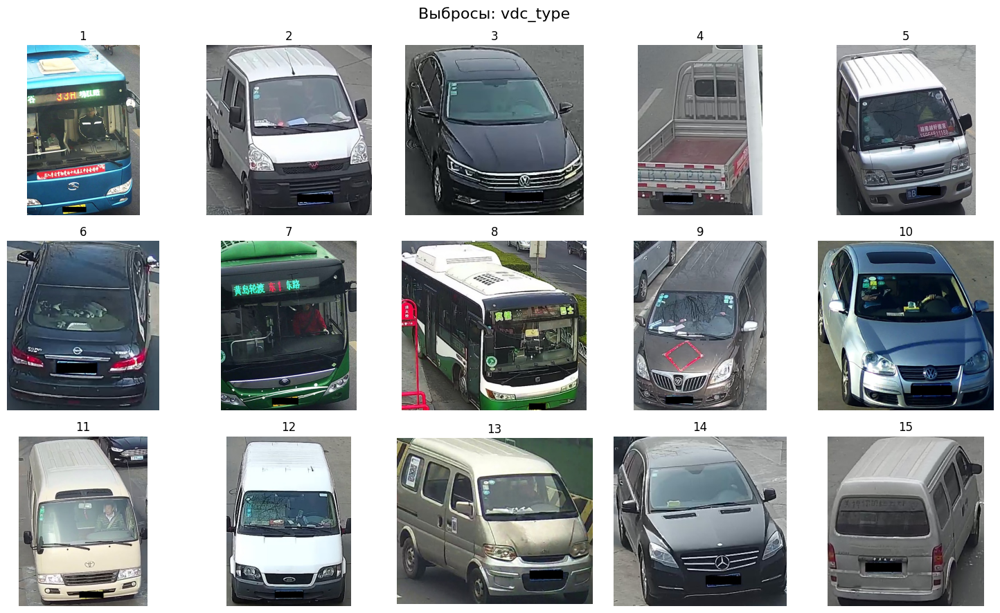

In [18]:
num_images = 15 # количество картинок по каждому дескриптору
images_per_row = 5 # столько расположено в ряд

for descriptor, image_paths in paths_escape.items():
    print(f'\n🔍 Дескриптор: {descriptor}')
    
    selected_paths = image_paths[:num_images]
    
    # Вычисляем количество строк
    num_rows = (len(selected_paths) + images_per_row - 1) // images_per_row
    
    # Настраиваем размер фигуры: ширина зависит от количества в ряду, высота — от количества строк
    plt.figure(figsize=(images_per_row * 3, num_rows * 3))
    
    for i, img_path in enumerate(selected_paths):
        try:
            img = mpimg.imread(img_path)
            plt.subplot(num_rows, images_per_row, i + 1)
            plt.imshow(img)
            plt.axis('off')
            plt.title(f'{i+1}')
        except Exception as e:
            print(f'⚠️ Ошибка при загрузке {img_path}: {e}')
    
    plt.suptitle(f'Выбросы: {descriptor}', fontsize=16)
    plt.tight_layout()
    plt.show()


Получили выбросы для каждого дескриптора в отдельности. Большинство из них визуально можно действительно определить как выбросы. В дескрипторе 
osnet  вывелось множество нестандартных изображений,не целиком снятые автобусы, редких расцветок, с посторонними предметами, попавшими в изображение. 

В дескрипторе vds_color практически все выбросы имеют трудно определимые расцветки. Это пожалуй самые хорошо определяемые на глаз выбросы. 

В vdc_type также видно около половины транспортных средств очень странного вида или снятых точно сзади, точно спереди или частично или непонятного типа.  В общем, выбросы виднны даже чисто визуально.

## 4. Выводы и оформление проекта

На основе результатов, полученных при выполнении проекта, сделайте вывод по задаче, приведя таблицу со сравнением результатов кластеризации на каждом из наборов дескрипторов. Приведите сравнение вариантов предобработки исходных данных по качеству кластеризации.

Результатом вашей работы должно стать небольшое исследование, в котором вы даёте команде IntelliVision рекомендации, какие дескрипторы, с какой предобработкой и каким алгоритмом кластеризации лучше всего подходят для решения задачи.

Также сохраните результаты лучшего алгоритма в CSV-файл со столбцами path (путь до изображения) и cluster (номер кластера). В описании к проекту приведите расшифровку каждого из кластеров.

Когда вы закончите выполнять проект, создайте в своём репозитории файл README.md и кратко опишите содержание проекта по принципу, который мы приводили ранее.

Выложите свой проект на GitHub и оформите удалённый репозиторий, добавив в него описание и теги (придумайте их самостоятельно в зависимости от того, какую задачу вы решали).

**Выведем таблицу по результатам кластеризации каждым методом каждого дескриптора**

In [24]:
def get_cluster_metrics_table(cluster_scores, target_k):
    rows = []

    for descriptor, df in cluster_scores.items():
        for method in df['method'].unique():
            method_df = df[(df['method'] == method) & (df['n_clusters'] == target_k)]
            if not method_df.empty:
                row = {
                    'descriptor': descriptor,
                    'method': method,
                    'n_clusters': target_k,
                    'calinski_harabasz': method_df['calinski_harabasz'].values[0],
                    'davies_bouldin': method_df['davies_bouldin'].values[0]
                }
                rows.append(row)

    result_df = pd.DataFrame(rows)

    # Настройка ширины вывода
    pd.set_option('display.max_columns', None)
    pd.set_option('display.width', 1000)
    pd.set_option('display.colheader_justify', 'center')

    return result_df

# Пример: таблица для k = 5
metrics_table_k5 = get_cluster_metrics_table(cluster_scores, target_k=2)
print(metrics_table_k5)


      descriptor        method      n_clusters  calinski_harabasz  davies_bouldin
0   efficientnet-b7         KMeans       2         33947.025117       2.763999   
1   efficientnet-b7          Birch       2          2612.317474       2.287050   
2   efficientnet-b7  Agglomerative       2          2612.317474       2.287050   
3             osnet         KMeans       2        390220.929865       0.619926   
4             osnet          Birch       2         35271.773671       0.738593   
5             osnet  Agglomerative       2         36024.454184       0.700689   
6         vdc_color         KMeans       2         78891.697897       2.193067   
7         vdc_color          Birch       2          6991.612947       2.332381   
8         vdc_color  Agglomerative       2          7015.782076       2.319820   
9          vdc_type         KMeans       2        137272.863641       1.192369   
10         vdc_type          Birch       2         13012.121678       1.236809   
11         vdc_t


Данная кластеризация основана на предобработке Rubastscaler. Сразу же бросается в глаза довольно убедительная CH метрика и весьма высокая DB метрика. Это означает, что центры кластеров находятся на хорошем расстоянии друг от друга, но их границы сильно перекрываются. Ровно это мы можем наблюдать визуально на трехмерных графиках и на примерах вывода изображений. 

Видно, что метод KMeans на всех дескрипторах дает хорошие результаты , методы Birch и Agglomerative тоже подходят только на всех дескрипторах, но с меньшими значениями CH метрики. Предобработка Rubast дает лучшее значение DB метрики в osnet дескрипторе. 

Значение около DB = 0.5 говорит об удовлетворительном перекрытии кластеров, в то время как значения DB = 1.5 - 2.8 говорит о существенном перекрытии кластеров. Кроме того, Rubast очень точно выявляет выбросы. На втором месте по удовлетворительности дает предобработка  Minmaxscaler. Эта предобработка дает не очень большое финальное количества признаков, но во всех случаях существенное перекрытие кластеров. Standartscaler дает весьма большее количество признаков и менее выраженные выбросы.  Предобработка в виде Normalizer, PowerTransformer,Quantile Transformer стойко вылетает по памяти.

Таблица df_paths формата, в которой находятся короткие пути и номер кластера ( от 0 до 4) для метода KMEANS сохранена  
в файл image_paths_with_kmeans_clusters.csv

In [5]:
paths_data = pd.read_csv('image_paths_with_kmeans_clusters.csv')
display(paths_data)

,paths,cluster
0,veriwild\1\00001\000001.jpg,4
1,veriwild\1\00001\000002.jpg,4
2,veriwild\1\00001\000003.jpg,4
3,veriwild\1\00001\000004.jpg,4
4,veriwild\1\00001\000005.jpg,4
...,...,...
416309,veriwild\9\36189\369999.jpg,3
416310,veriwild\9\36190\370000.jpg,1
416311,veriwild\9\36190\370001.jpg,1
416312,veriwild\9\36190\370002.jpg,1
